<a href="https://colab.research.google.com/github/gardiens/MVA_24_25/blob/main/MVA_SAT/TP5/tp2_interferometry_2025.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Practical work on SAR interferometry

### Florence Tupin, Christophe Kervazo, Emanuele Dalsasso

Images of the practical work can be found on:
https://perso.telecom-paristech.fr/tupin/TPSAR/

You have:
- Terrasar-X images of metric resolution on Grand canyon in Colorado.
- ERS-1/ERS-2 images acquired on Etna volcano.
For each pair of images, we will compute the interferogram.

Some useful functions are available in the file *mvalab.py*.

### Name:Pierrick Bournez

#### Instructions

To solve this practical session, answer the questions below. Then export the notebook with the answers using the menu option **File -> Download as -> Notebook (.ipynb)**. Then [submit the resulting file here] https://partage.imt.fr/index.php/s/xsneCr8KPN4n2no by next week (deadline 21st of february).

### Import the libraries and packages we are going to use
The following cell imports all that is going to be necessary for the practical work

In [ ]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

--2025-02-14 15:50:30--  https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.22.227, 2a04:8ec0:0:a::89c2:16e3
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68071 (66K) [text/x-python]
Saving to: ‘mvalab.py.1’

mvalab.py.1         100%[===================>]  66,48K  --.-KB/s    in 0,004s  

2025-02-14 15:50:31 (18,1 MB/s) - ‘mvalab.py.1’ saved [68071/68071]



In [1]:
import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath


plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

## A. Visualization of the Grand Canyon and its interpretation

To recall from the previous practical work:
* Download of images using `mvalab.imz2mat`
* Visualization of amplitude images, phase and Fourier spectrum. Useful functions:
    * `mvalab.visusar`
    * `mvalab.visuinterfero` and `np.angle`
    * `mvalab.visusarspectre`

### Visualization of an image

The function to display a SAR image with an adapted thresholding of the values is
`mvalab.visusar`. The first argument containing the image is compulsary, and the second one is
optional and corresponds to a threshold for the display.
The value $\alpha$ defines the threshold in this way :

${\rm thres} \:\:=\:\: {\rm vmean} \:\: + \:\: \alpha \: {\rm std}$


vmean is the mean value and std the standard deviation computed on the whole image. Every pixel whose value is above this threshold is displayed with the maximal value.  

When $\alpha$ is 0, the image is displayed with the full dynamic range.
A usual value to display SAR images is 3.

### Vizualisation of a phase image

Use `mvalab.visuinterfero` on the phase (do not forget the `np.angle` function, and to set the full range dynamic).

### Spectral analysis
To visualize an image and its spectrum (with automatic thresholding for the display), use the function `mvalab.visusarspectre`.


   

In [2]:
url='https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/'
imagesar=mvalab.imz2mat(url+'TSX_GC_maitre.cxs')
tableauimage=imagesar[0]
ncol=imagesar[1]
nlig=imagesar[2]

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/TSX_GC_maitre.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/TSX_GC_maitre.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
2 2048 >h


Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


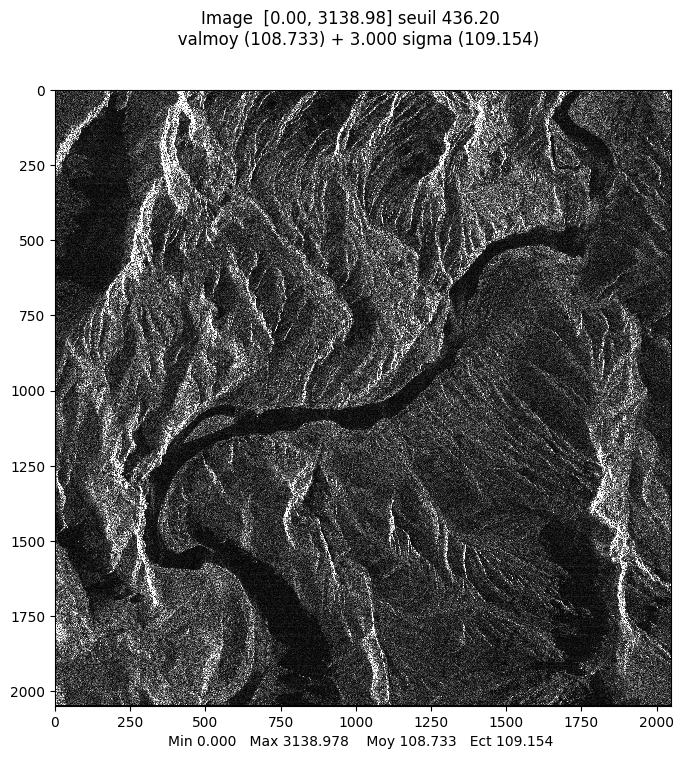

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


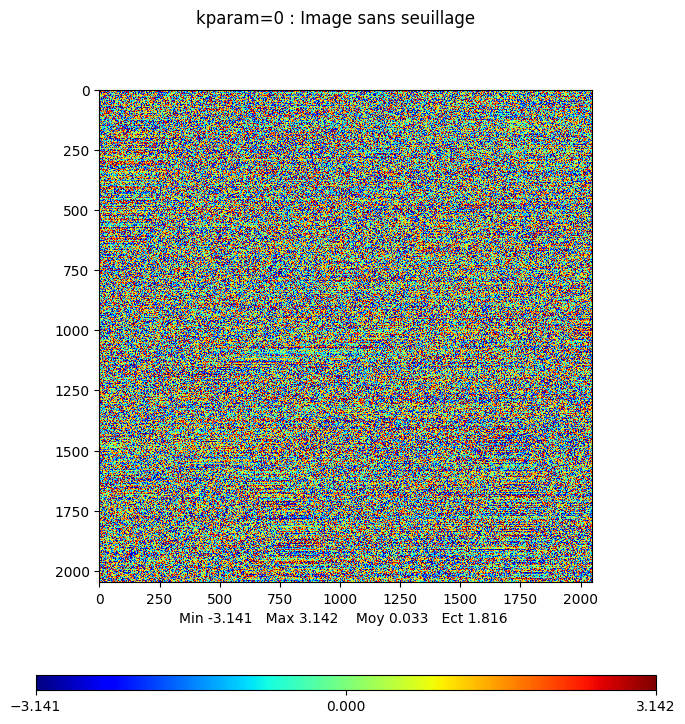

Affichage d'une image complexe : on prend le module
Visusar sans plt.show, ni titre
Affichage d'une image complexe : on prend le module
Visusar sans plt.show, ni titre


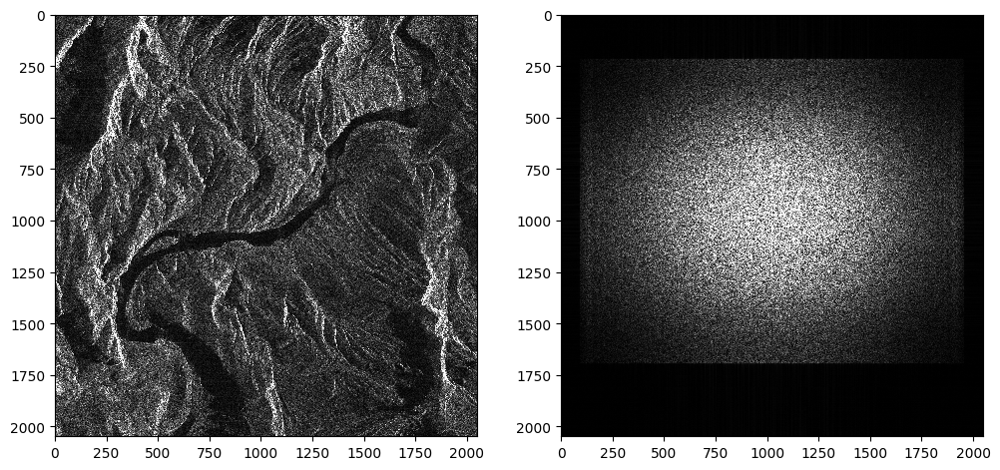

In [3]:
mvalab.visusar(tableauimage)
mvalab.visuinterfero(np.angle(tableauimage),0)
mvalab.visusarspectre(tableauimage)

## B. Terrasar-X data on Grand Canyon (Airbus): computation of the interferogram

##### Parameters values for the TerraSAR-X data
These are free data provided by Airbus of Grand Canyon, Colorado, US.
The parameters of the sensor for this acquisition are the following:
- $\theta = 39.15^{\rm o}$  (for the master image)
- $R$ = 646 km  (hypothesis of spheric earth)
- $\lambda$ = 3.11 cm
- $B_{ortho}$ = 46.5 m
- $F_e$ = 109.89 MHz

These values will be used in the following to compute the contribution of the phase ramp corresponding to the orbital fringes.

### Registration of the two original SAR images: pixellic registration
The two images to consider are the following:
- TSX_GC_maitre.cxs
- TSX_GC_esclave.cxs

These images are complex images. Thus we have the phase information, which, to recall, is directly linked to the distance between the radar and the ground ($\phi=4\pi R / \lambda$).
They are given in their original geometry of acquisition.
Thus, they are not directly super-imposable and we must register the slave image on the master one.

To do a registration at the pixel scale, you can find the maximum of the cross-correlation between the two amplitude images $a_1$ and $a_2$, being the maximum of

$\tilde{a}_1 \star a_2$

with $\tilde{a}_1(i,j) = a_1(-i,-j)$
This is done in the Fourier domain by computing the hermitian product of the two Fourier transforms.
Then the inverse Fourier tansform gives the correlation image:

$\tilde{a}_1 \star a_2 = \mathcal{F}^{-1}\{ \mathcal{F}\{a_1\}^{*} \cdot \mathcal{F}\{a_2\} \} $

### Question 1
Compute the translation to apply and give its value. What is the shift you obtain?

### Answer 1


imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/TSX_GC_maitre.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/TSX_GC_maitre.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
2 2048 >h
imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/TSX_GC_slave.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/TSX_GC_slave.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
2 2048 >h
Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


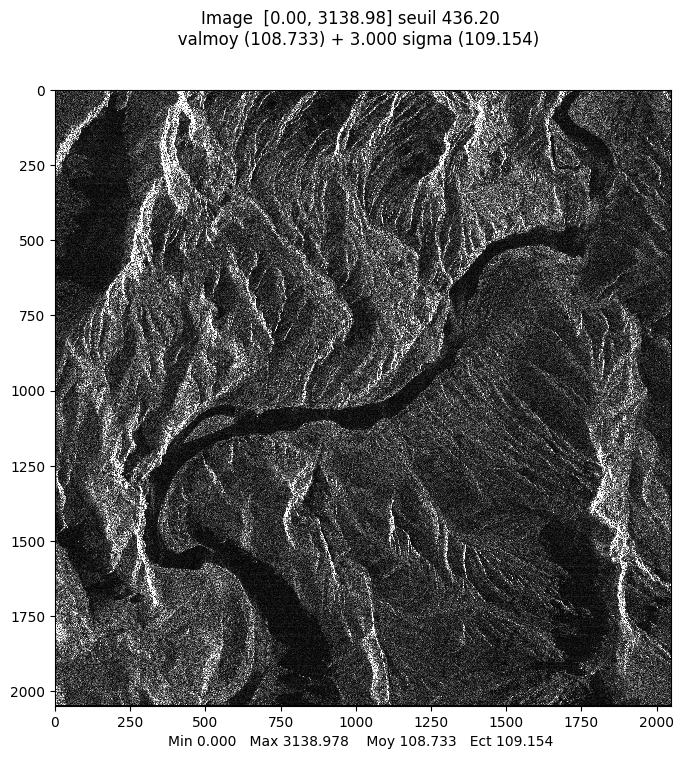

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


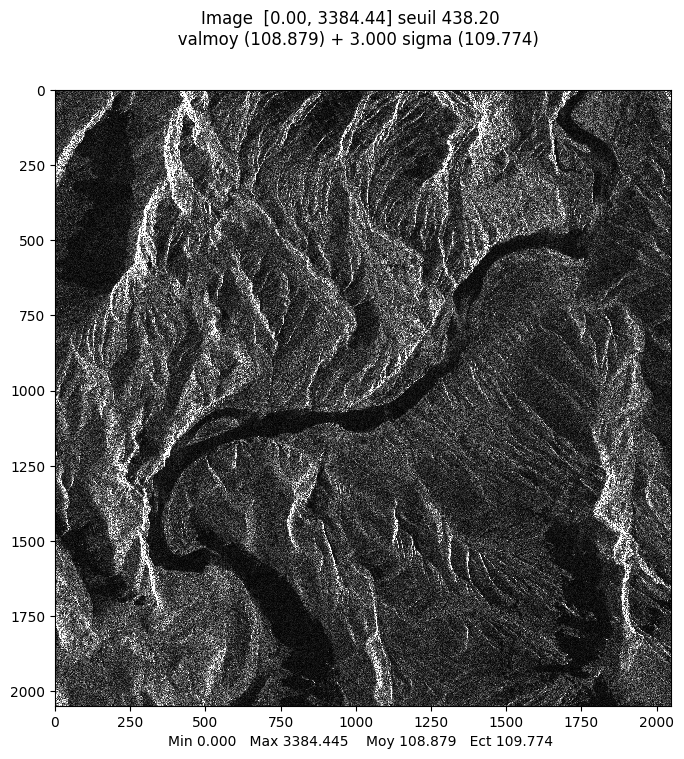

array([[  0.        ,  66.61080993,  22.20360331, ..., 131.487642  ,
        148.33745313,  88.52683209],
       [  0.        ,  36.76955262,  19.02629759, ..., 106.06601718,
        261.72504657, 293.12795841],
       [  0.        ,  78.23042886,  53.07541804, ...,   9.8488578 ,
        171.95929751, 314.24990056],
       ...,
       [  0.        ,  41.59326869,  92.76313923, ...,  94.5409964 ,
        177.07907838, 205.50669089],
       [  0.        ,  75.10659092, 159.76545309, ...,  58.00862005,
        138.3220879 , 213.97429752],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]])

In [28]:
url='https://perso.telecom-paristech.fr/tupin/TPSAR/imagesinterf/'
imamaitre=mvalab.imz2mat(url+'TSX_GC_maitre.cxs')
imaslave = mvalab.imz2mat(url+'TSX_GC_slave.cxs')
mvalab.visusar(imamaitre[0])
mvalab.visusar(imaslave[0])

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


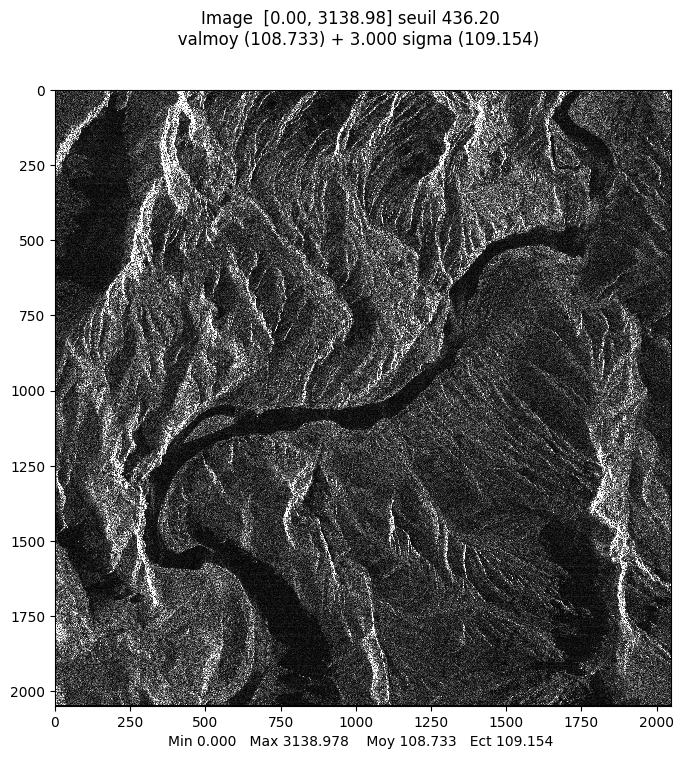

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


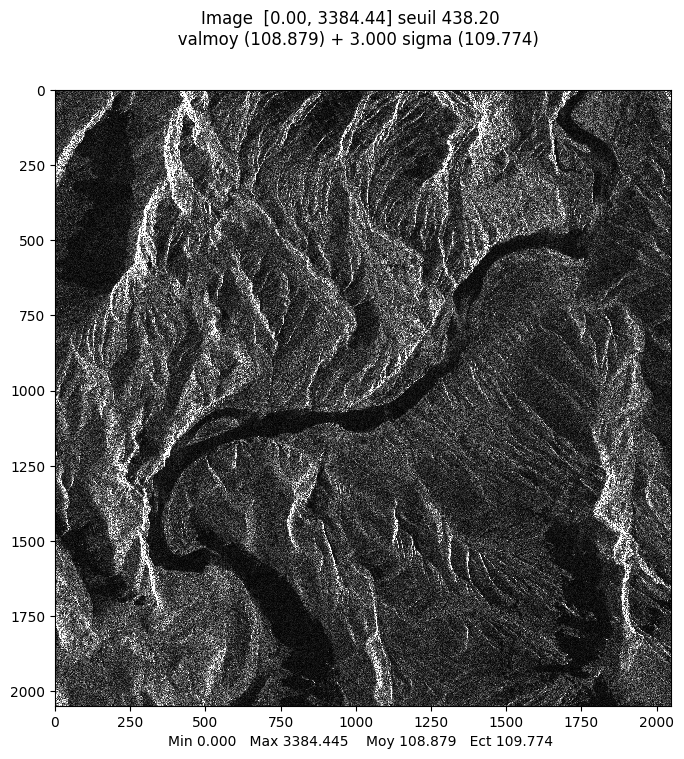

array([[  0.        ,  66.61080993,  22.20360331, ..., 131.487642  ,
        148.33745313,  88.52683209],
       [  0.        ,  36.76955262,  19.02629759, ..., 106.06601718,
        261.72504657, 293.12795841],
       [  0.        ,  78.23042886,  53.07541804, ...,   9.8488578 ,
        171.95929751, 314.24990056],
       ...,
       [  0.        ,  41.59326869,  92.76313923, ...,  94.5409964 ,
        177.07907838, 205.50669089],
       [  0.        ,  75.10659092, 159.76545309, ...,  58.00862005,
        138.3220879 , 213.97429752],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]])

In [29]:
#take a subpart of the image to highlight the phase shift
mvalab.visusar(imamaitre[0][:,:]) # to be completed
mvalab.visusar(imaslave[0][:,:]) # to be completed

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


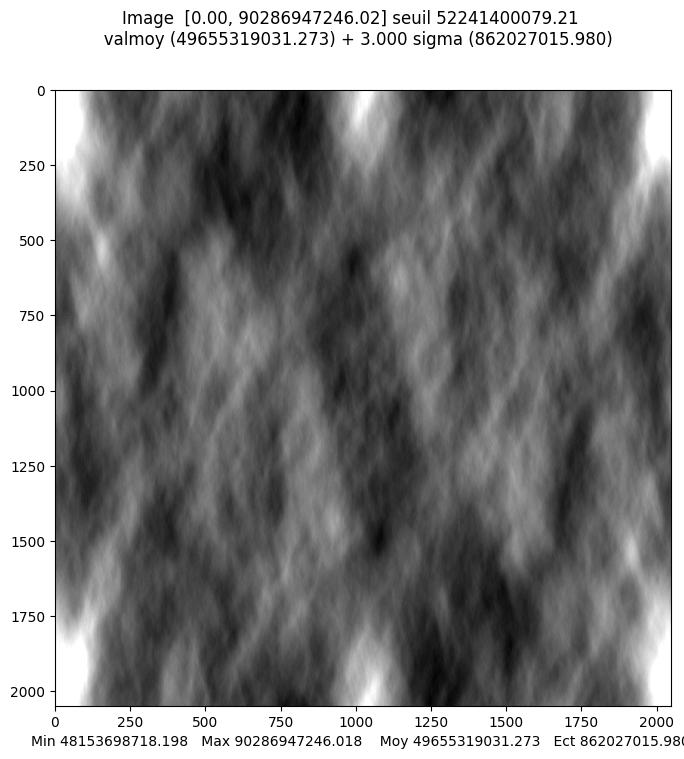

--- phase difference ---
Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


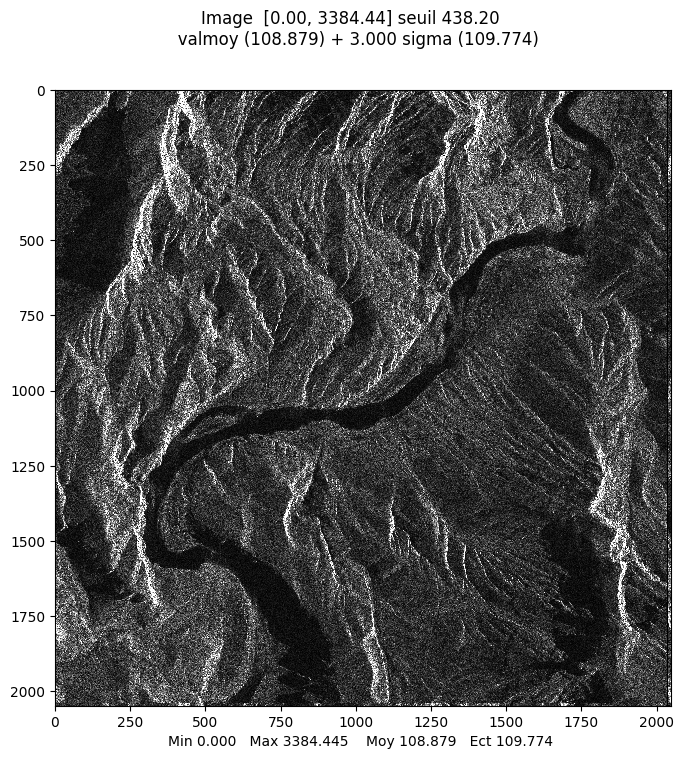

array([[115.52056094, 153.4177304 ,  46.        , ...,  98.47842403,
         98.79271228,  95.12623192],
       [ 19.6468827 ,  48.16637832,  58.05170109, ...,  72.6704892 ,
         73.35529974,  23.76972865],
       [ 87.92041856,  49.39635614,  14.14213562, ...,  33.54101966,
         60.41522987,  21.9317122 ],
       ...,
       [ 16.76305461,  50.60632372, 118.18629362, ..., 106.00471688,
         77.02596965,  31.95309062],
       [ 86.72946443,  27.01851217, 103.12128781, ..., 135.09256086,
        122.37646833,  66.21933252],
       [155.75621978, 169.33103673,  73.1641989 , ...,  96.04165763,
        125.28367811, 116.43023662]])

In [30]:
# compute cross-correlation
ima1fft=np.fft.fft2(np.abs(imamaitre[0]))
ima2fft=np.fft.fft2(np.abs(imaslave[0]))

imacorfft = np.multiply(np.conjugate(ima1fft),ima2fft ) # to be completed
imacor=np.fft.ifft2(imacorfft)

mvalab.visusar(imacor)

# extract the index corresponding to the maximum value
idecalage=np.unravel_index(np.argmax(np.abs(imacor)), imacor.shape)
print('--- phase difference ---')

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave[0],-idecalage[0] , axis=0) # to be completed
imaslaveroll=np.roll(imaslaveroll,-idecalage[1] , axis=1) # to be completed
mvalab.visusar(imaslaveroll)

In [32]:
print("we applied the shift:",-idecalage[0],-idecalage[1])

we applied the shift: -9 -12


We got a shift of -9 and -12 from the slave space to the image space

### Question 2
Compute the interferogram by computing the hermitian product between the two registered images (pixel by pixel, 1-look interferogram). What do you see ? Compare with the interferogram before doing the registration.

### Answer 2
Before registration, the interferogram appears as mere noise without any discernible shape. The fringes are not visible, and no significant structure can be identified.

After registration, the interference fringes start to emerge, revealing structured patterns. This allows for the identification of features such as the river, which was previously obscured by noise. The phase information becomes coherent, highlighting topographic variations and possible surface displacements.

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


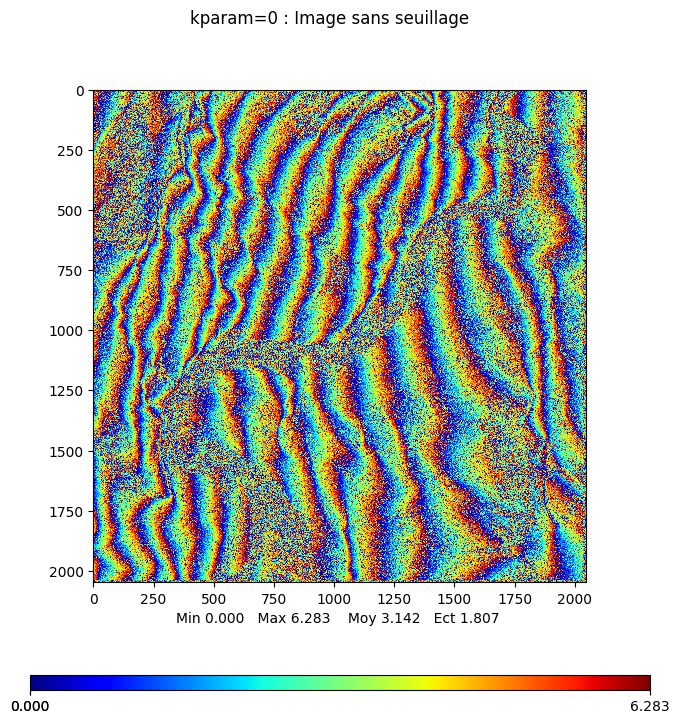

array([[3.14159265, 3.14159265, 4.49551536, ..., 1.02102588, 1.57717583,
        1.32877987],
       [6.28318531, 3.14159265, 4.69440666, ..., 1.77082558, 1.66060972,
        1.11735245],
       [3.14159265, 3.14159265, 4.44613693, ..., 3.44753425, 0.81775294,
        3.0437466 ],
       ...,
       [3.14159265, 1.14549143, 5.61813046, ..., 5.31814154, 4.5620658 ,
        1.98185293],
       [3.14159265, 6.28318531, 3.14159265, ..., 3.14159265, 3.14159265,
        3.14159265],
       [3.14159265, 3.14159265, 6.28318531, ..., 3.14159265, 3.14159265,
        3.14159265]])

In [7]:
# compute the interferogram and plot the interferometric phase
interfero=np.multiply(np.conj(imaslaveroll),imamaitre[0]) # to be completed
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Orbital fringe correction: subpixellic registration
The two images are almost registered but in practice the ground cells are slightly different since they have not been taken under the exact same incidence angle.  

For an image with *n* columns, the phase shift is (see course)

$\Delta \phi = \frac{4\pi B_{orth} cos\theta}{\lambda R} n\Delta x$

with

$\Delta x = \frac{c}{2F_{e}sin\theta}$  


To take into account this phase shift for each pixel, apply a phase shift, "dephasage" value being the whole phase shift for the number of pixels in range of the image.




```
rampephase=np.linspace(0.,dephasage,ncolonnes)
malignephase=np.exp(1j*rampephase)
imaslavefine=np.multiply(imaslaveroll,malignephase)
```


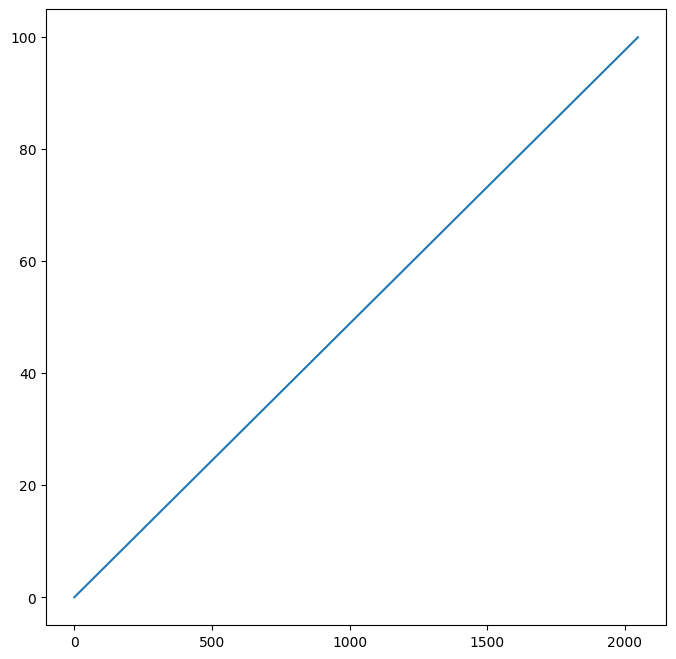

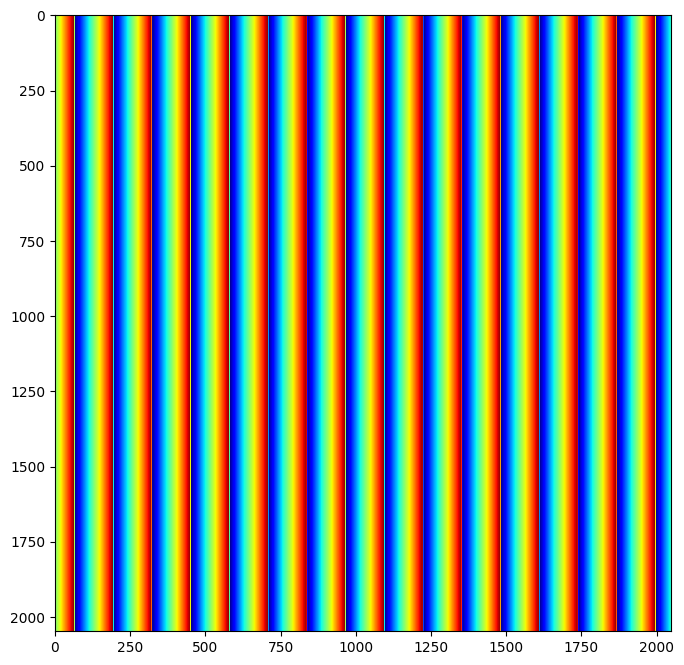

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


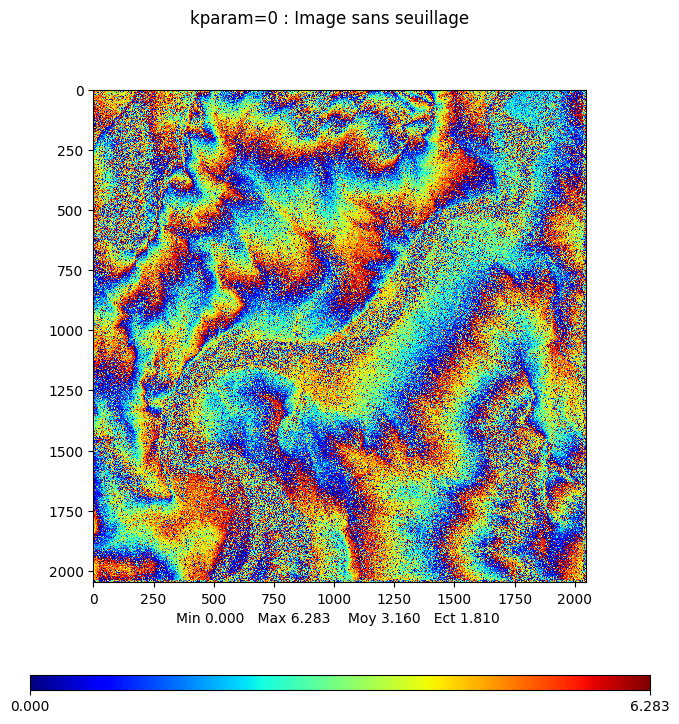

array([[3.14159265, 3.14159265, 4.39793725, ..., 1.77837116, 2.28573205,
        1.98854704],
       [6.28318531, 3.14159265, 4.59682854, ..., 2.52817086, 2.36916594,
        1.77711961],
       [3.14159265, 3.14159265, 4.34855882, ..., 4.20487953, 1.52630916,
        3.70351377],
       ...,
       [3.14159265, 1.09670237, 5.52055235, ..., 6.07548682, 5.27062202,
        2.6416201 ],
       [3.14159265, 6.28318531, 3.14159265, ..., 3.14159265, 3.14159265,
        3.14159265],
       [3.14159265, 3.14159265, 6.28318531, ..., 3.14159265, 3.14159265,
        3.14159265]])

In [48]:
# Parameters of the sensor
theta = 39.15*np.pi/180 #rad
lambd = 3.11e-2 #m
Fe = 109.89e6 #Hz
Borth = 46.5 #m
R = 646e3 #m
c = 3e8 #m/s
ncolonnes=imamaitre[0].shape[1]
# Compute the phase shift
delta_x = c/(2*Fe*np.sin(theta))# to be completed
dephasage =4*np.pi*Borth*np.cos(theta)/(lambd*R)*delta_x*ncolonnes  # to be completed (global phase shift for the whole image)

# Compute the phase shift for each image pixel for one line in an array
rampephase= np.linspace(0.,dephasage,ncolonnes) # to be completed


plt.figure()
plt.plot(rampephase)
plt.show()

malignephase=np.exp(1j*rampephase)

# Visualize the orbital fringes
orbital_fringes = np.ones((imamaitre[0].shape), dtype=np.complex128)
for juv in range(imamaitre[2]):
    orbital_fringes[juv,:]= malignephase
plt.figure()
plt.imshow(np.angle(orbital_fringes),cmap='jet')
plt.show()

# Register the slave image
imaslavefine = np.multiply(imaslaveroll,malignephase) # to be completed

#compute the new interferogram and comment the effect of the fine registration
# compute the interferogram and plot the interferometric phase
interfero=np.multiply(np.conj(imaslavefine),imamaitre[0]) # to be completed
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)


Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


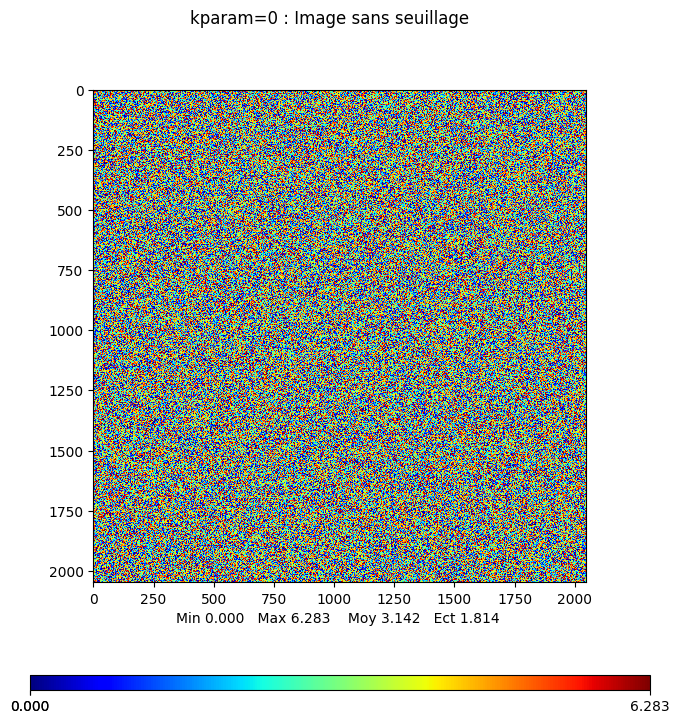

array([[3.14159265, 3.14159265, 5.44082665, ..., 2.06316407, 3.63481462,
        4.49804424],
       [3.14159265, 3.14159265, 4.0103334 , ..., 3.43947034, 3.54442679,
        3.72733746],
       [3.14159265, 3.14159265, 3.76265714, ..., 3.68590508, 3.29197072,
        3.37738114],
       ...,
       [3.14159265, 3.93949017, 5.8410734 , ..., 2.36678214, 0.13843001,
        5.63123929],
       [3.14159265, 3.14159265, 3.14159265, ..., 6.28318531, 3.14159265,
        3.14159265],
       [3.14159265, 3.14159265, 3.14159265, ..., 3.14159265, 3.14159265,
        3.14159265]])

In [49]:
# compute the interferogram and plot the interferometric phase
interfero=np.multiply(imaslave[0],imamaitre[0]) # to be completed
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)


### Question 3
Compute the interferogram by computing the hermitian product between the two finely registered images (pixel by pixel, 1-look interferogram). What do you see ?


### Answer 3 ( same answer as the question seems similar)
Before registration, the interferogram appears as mere noise without any discernible shape. The fringes are not visible, and no significant structure can be identified.

After registration, the interference fringes start to emerge, revealing structured patterns. This allows for the identification of features such as the river, which was previously obscured by noise. The phase information becomes coherent, highlighting topographic variations and possible surface displacements.

### Computation of the filtered interferogram
To compute now the interferometric product, you have to compute the multi-look hermitian product given by the formula :

$d(i,j)= {\gamma(i,j) e}^{j \phi(i,j)}$

$d(i,j)=\frac{\sum_{(i',j') \in {{V}}(i,j)} I_m(i',j')I_s^*(i',j')}
{
\sqrt{\sum_{(i',j') \in {{V}}(i,j)} I_m(i',j')I_m^*(i',j')}
\sqrt{\sum_{(i',j') \in {{V}}(i,j)} I_s(i',j')I_s^*(i',j')} }
$

the usual neighborhood is a square of size 3$\times$3 pixels.
It gives :
- the interferometric phase (argument of the output, $\phi(i,j)$)
- the coherence (modulus of the output $\gamma(i,j)$ ) reflecting the quality of the interferometric phase


### Question 4
Compute and compare the interferometric product for the two images (master and slave) in the following cases:
- using the raw images, without any correction
- with the pixellic registration
- with the sub-pixellic phase shift

You can fill the python function "interferogramme" to compute the complex interferogram.

Comment the differences between the three inteferograms.
Try to modify the size of window used to compute the multilooked interferogram and explain what happens.



### Answer 4
We observe the following differences in the interferograms for the three cases:

Using raw images (without any correction): The interferogram is dominated by noise, and no clear pattern or structure can be identified. The phase information is highly decorrelated due to misalignment between the master and slave images.

With pixel-level registration: The alignment improves, and several interference fringes become visible. The phase information is more coherent, and significant features such as the river can be identified. However, some residual misalignment may still be present, leading to phase distortions.

Using sub-pixel phase shift correction: The interferogram exhibits only one dominant fringe, with smoother phase variations. The phase noise is reduced.

As we augment the size of the window, the color appears sharper and  noise are increasingly removed.
 When we are under small window size the interferogram retains high spatial resolution but the phase is noisy. With lager window size, the phase noise is averaged but at the cost of spatial resolution loss. The fringe appear smoother but with less detailed structures. 

The interferogram appears to stabilize for a window size of approximately 30 to 40 pixels.

In [41]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase
    is the interferometric phase.
    """

    dimx=3
    dimy=3

    if(len(therest)==1):
        dimx=therest[0]
        dimy=dimx

    if(len(therest)==2):
        dimx=therest[0]
        dimy=therest[1]

    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)

    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0

    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0

    # single look interferogram before averaging
    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window
    mask = np.ones((dimx,dimy))/(dimx*dimy) # carré de taille (n,n) de 1
     # to be completed (to do an averaging with dim x and dimy window size)
    print(interf.shape)
    interfiltr =scipy.signal.convolve2d(interf,mask,mode="same")
    # to be completed - numerator part

    den1 =np.sqrt(scipy.signal.convolve2d(np.abs(tabvignette),mask,mode="same"))
    # to be completed - denominator part for tabvignette
    den2 = np.sqrt(scipy.signal.convolve2d(np.abs(tabvignette2),mask,mode="same"))
    # to be completed - denominator part for tabvignette2

    return interfiltr/(den1*den2+1e-12)

 coherence and interferogram with pixel registration
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


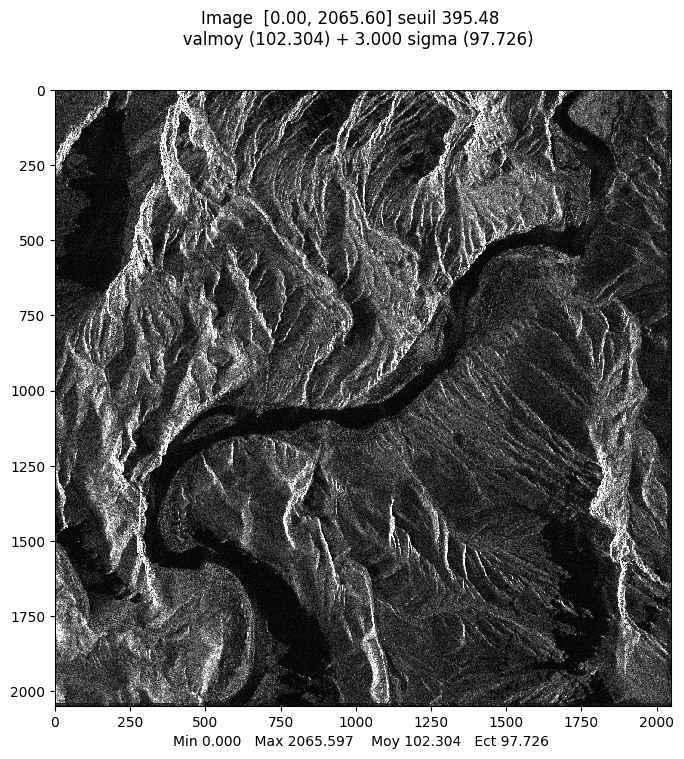

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


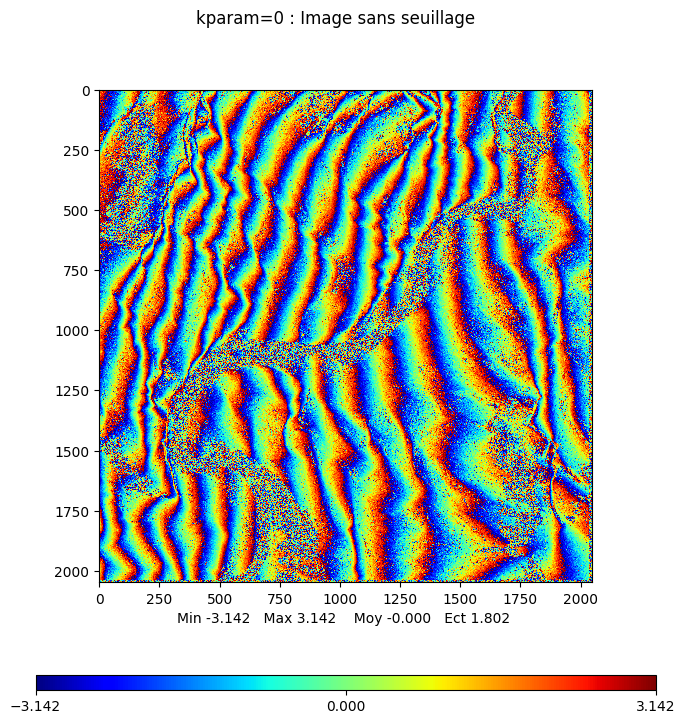

array([[ 0.        ,  1.45136008,  1.18926997, ..., -1.64283705,
        -1.70119445, -1.65905972],
       [ 0.        ,  1.44834631,  1.19183457, ..., -1.72280729,
        -1.66718891, -1.65085721],
       [ 0.        ,  1.71793436,  1.75057203, ..., -1.4006614 ,
        -1.40840277, -1.66268845],
       ...,
       [ 1.88864573,  2.64309445, -3.09777382, ...,  1.96248107,
         1.7311131 ,  0.37074604],
       [-1.99610123,  2.60957689, -3.0593014 , ...,  1.8628391 ,
         1.91145225,  0.85100086],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ]])

In [47]:
# compute the  interferogram with pixel registration
print(" coherence and interferogram with pixel registration")
interf=interferogramme(imamaitre[0],imaslaveroll) # here you can modify the size of the local window

mvalab.visusar(np.abs(interf))
mvalab.visuinterfero(np.angle(interf),0)

(2048, 2048)
 coherency with subpixellic registration
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


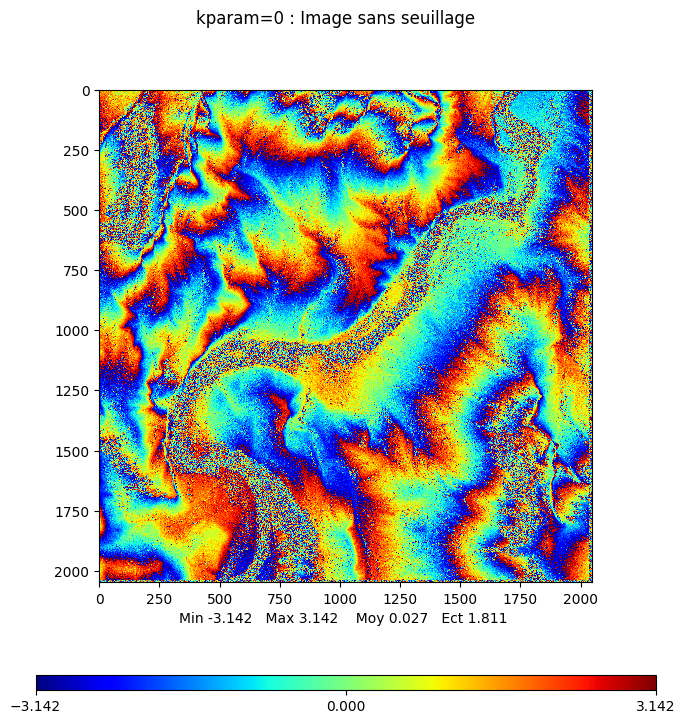

 coherency without registration
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


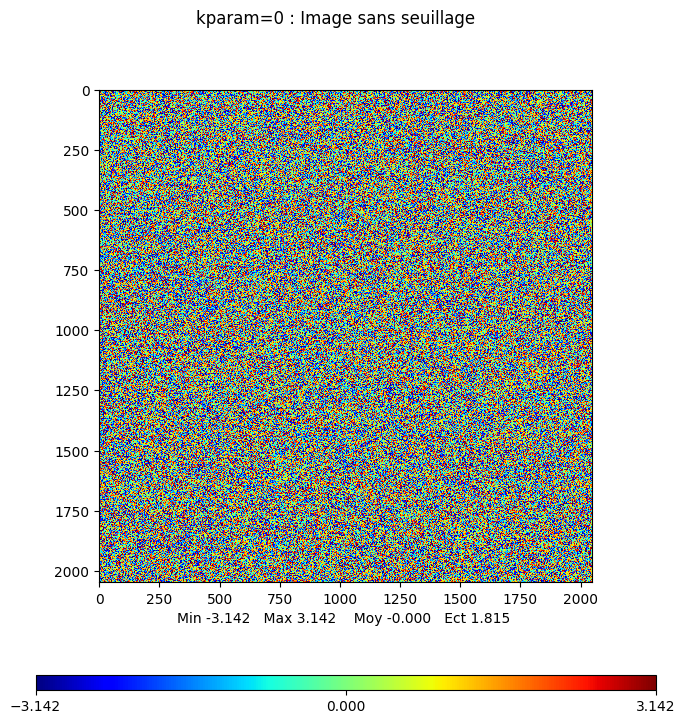

array([[ 0.        ,  0.54835397,  3.0476256 , ..., -2.29368518,
        -2.21914933, -2.23991916],
       [ 0.        ,  0.74544565, -2.9341467 , ..., -2.26343316,
        -2.39939613, -2.41914591],
       [ 0.        ,  1.13481617,  2.41132773, ..., -2.03884836,
        -2.53144147, -2.52602514],
       ...,
       [ 0.66775223,  0.2672437 ,  2.27475407, ...,  2.45002263,
         2.23447572,  2.10341983],
       [ 0.45969506,  0.00930104,  2.20776218, ...,  2.51688358,
         2.30410144,  2.39153075],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ]])

In [46]:
# COMPUTE THE COHERENCY on the image without subpixellic registration
interfnoramp=interferogramme(imamaitre[0], imaslavefine)

# mvalab.visusar(np.abs(interfnoramp))
print(" coherency with subpixellic registration")
mvalab.visuinterfero(np.angle(interfnoramp),0)

# COMPUTE THE COHERENCY on the image without any registration
print(" coherency without registration")
interfnoramp=interferogramme(imamaitre[0], imaslave[0])

# mvalab.visusar(np.abs(interfnoramp))
mvalab.visuinterfero(np.angle(interfnoramp),0)


compute the interferogram for a window size of  2
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


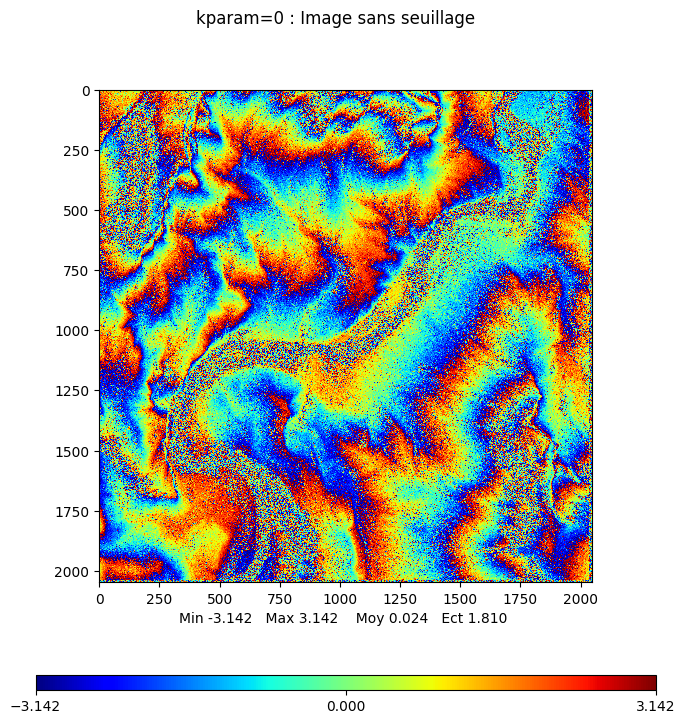

compute the interferogram for a window size of  5
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


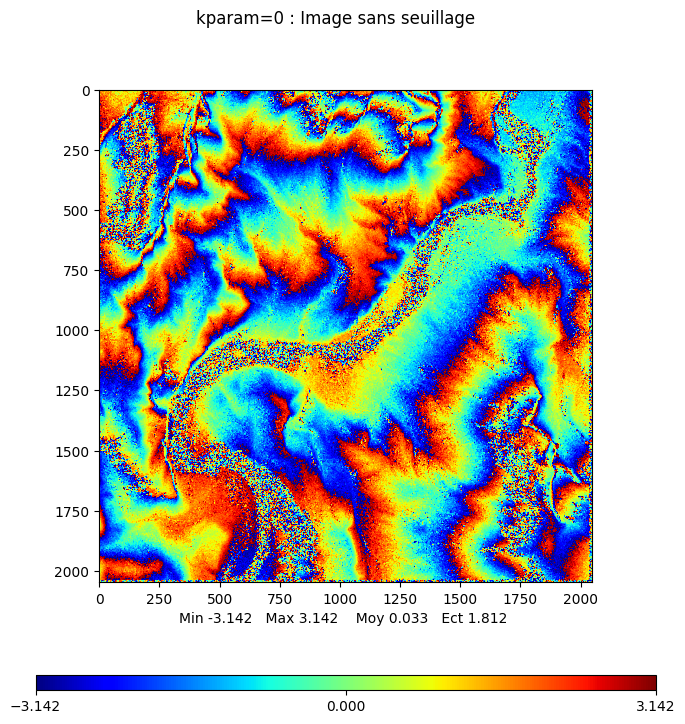

compute the interferogram for a window size of  10
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


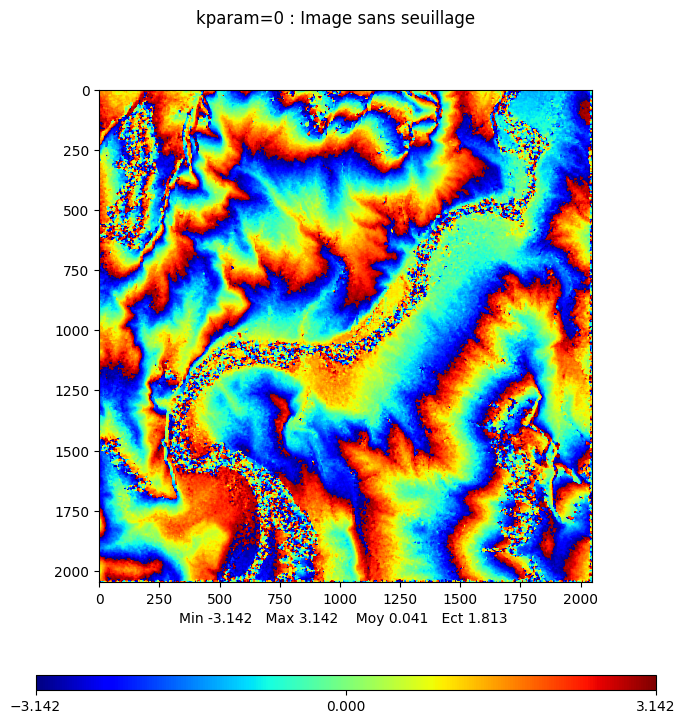

compute the interferogram for a window size of  15
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


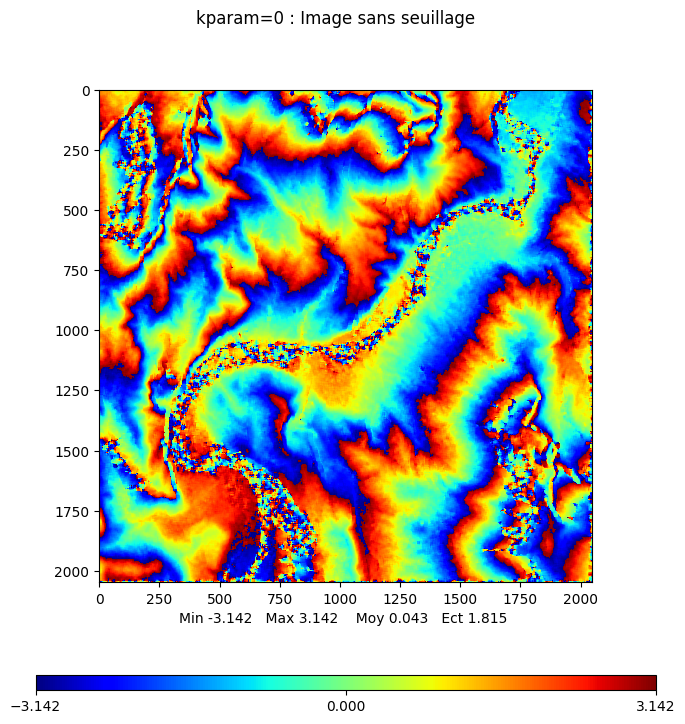

compute the interferogram for a window size of  30
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


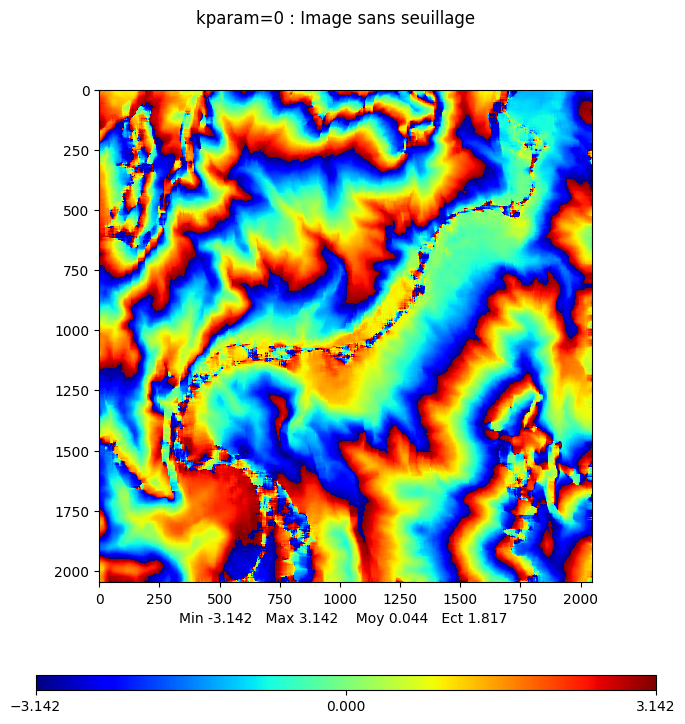

compute the interferogram for a window size of  40
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


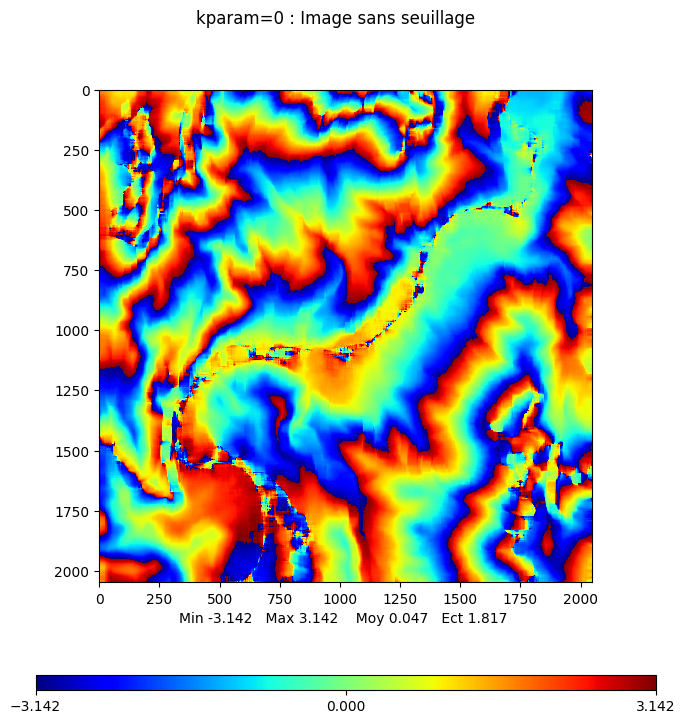

In [56]:
# COMPUTE THE COHERENCY on the image without subpixellic registration

for dimx in [2,5,10,15,30,40]:
    print("compute the interferogram for a window size of ",dimx)
    interfnoramp=interferogramme(imamaitre[0], imaslavefine,dimx)

    # mvalab.visusar(np.abs(interfnoramp))
    mvalab.visuinterfero(np.angle(interfnoramp),0)

### Question 5
Interpreting the fringes

When taking into account the phase shift due to pixel size differences, what do the left fringes
correspond to ?

Compute the ambiguity height given by :
    
$h_{amb} = \frac{\lambda R \: \sin \theta}{ 2 B_{ortho} }$

Which mean depth of the Grand Canyon can be deduced from the interferogram ? Explain.


### Answer 5
Fringes correspond here to terrain variations in the observed area. If the fringes are closely spaced, it indicates a steep gradient, while wider spacing suggests a more gradual change. If we ake into account the phase shift due to pixel size difference, it correspond to displacement of the scene. 

From the interferometric phase, the height difference can be estimated by counting the number of phase fringes by and multiplying the ambiguity height. 
We count 5 different phase fringe


We computed an ambiguity height of 136 m . 

The mean depth of this picture should be therefore $136*5$=680 m. 

In [12]:
h_amb=lambd*R*np.sin(theta)/(2*Borth)
h_amb #Hauteur maximale qu'on peut retrouver en deux phases.  Si on a n franges on a n* ambiguité
#Donc faire un calcul bizarre! 

136.3898545403792

## C. ERS data of Etna (SARedu data)

The following parameters have to be used for these data:
- $\theta = 20^{\rm o}$ (on est en ``near range'')
-  $R$ = 826 km  (hypothèse de Terre sphérique)
-  $\lambda$ = 5.66 cm
-  $B_{ortho}$ = -54.5 m
-  $F_e$ = 18.96 MHz

Do the same processing as before with these new data.


In [16]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat

--2025-02-14 21:28:55--  https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.22.227, 2a04:8ec0:0:a::89c2:16e3
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30320639 (29M)
Saving to: ‘Master.mat.2’

Master.mat.2        100%[===================>]  28,92M  82,7MB/s    in 0,3s    

2025-02-14 21:28:55 (82,7 MB/s) - ‘Master.mat.2’ saved [30320639/30320639]

--2025-02-14 21:28:55--  https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.22.227, 2a04:8ec0:0:a::89c2:16e3
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30607258 (29M)
Saving to: ‘Slave.mat.2’

Slave.mat.2         100%[============

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


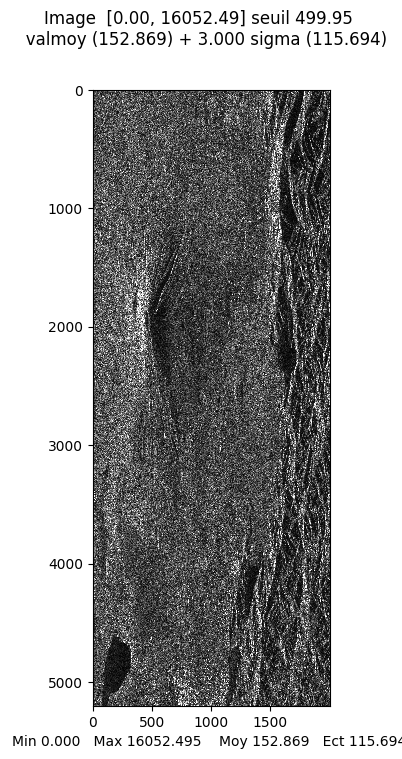

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


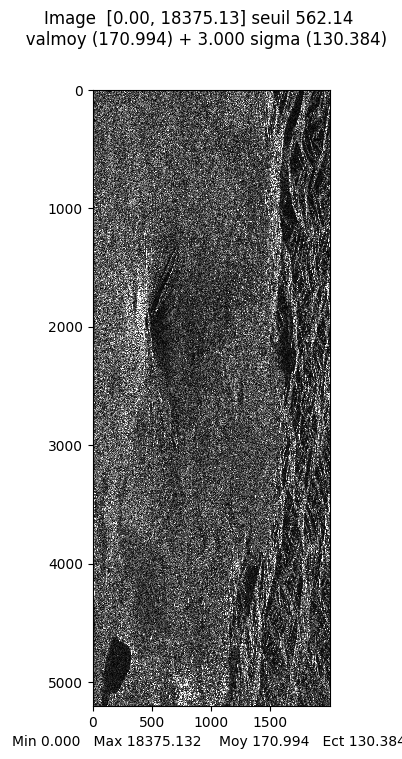

array([[111.25196627, 148.39474384, 328.95136419, ..., 125.60254774,
        315.22055771, 110.53506231],
       [127.90621564,  58.54912467, 158.14234095, ...,  42.        ,
        172.185946  , 112.29425631],
       [ 75.        ,  57.30619513, 114.38968485, ..., 254.18890613,
         90.47098983, 158.02847845],
       ...,
       [ 92.19544457, 144.47491132, 180.67927385, ...,  67.67569726,
        164.20109622,  57.42821606],
       [215.76144234, 111.87939935, 169.49926254, ...,  17.02938637,
         48.10405388,  35.51056181],
       [203.57799488,  81.04319836, 266.58019431, ...,  13.41640786,
         20.61552813,  34.40930107]])

In [58]:
imageM='./Master.mat'
imageS='./Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

ncolonnes=imamaitre[1]
nlignes=imamaitre[2]

#%%

mvalab.visusar(imamaitre[0])
mvalab.visusar(imaslave[0])

### Pixellic registration

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


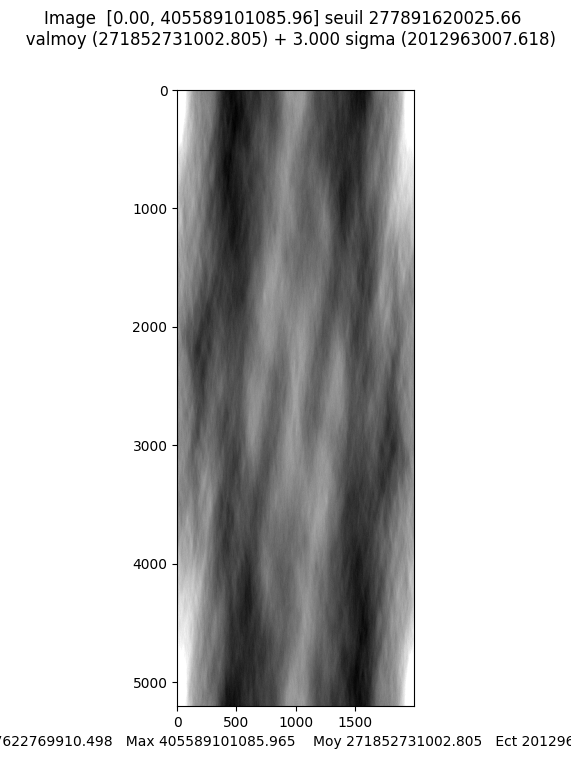

--- phase shift ---
(2, 0)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


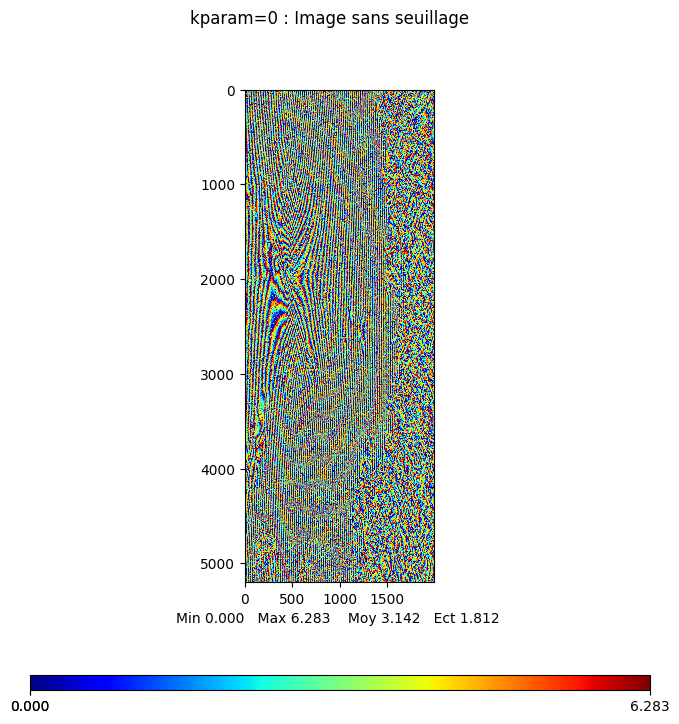

Affichage d'une image complexe : on prend le module
Visusar sans plt.show, ni titre
Affichage d'une image complexe : on prend le module
Visusar sans plt.show, ni titre


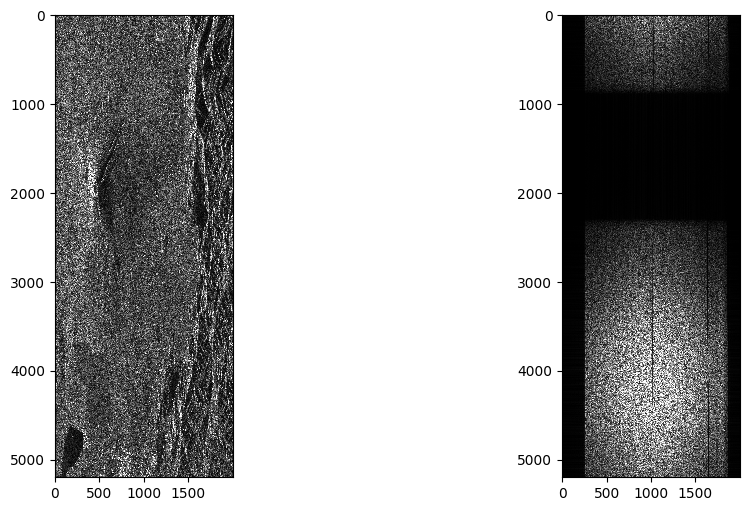

In [59]:
ima1fft=np.fft.fft2(np.abs(imamaitre[0]))
ima2fft=np.fft.fft2(np.abs(imaslave[0]))

# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT
imacorfft = np.multiply(np.conjugate(ima1fft),ima2fft ) # to be completed
imacor=np.fft.ifft2(imacorfft)


#visualize the correlation image (maximum gives the translation value)
mvalab.visusar(imacor)

# extract the index corresponding to the maximum value
idecalage=np.unravel_index(np.argmax(np.abs(imacor)), imacor.shape)
print('--- phase shift ---')
print(idecalage)

# compute the shift on the two axis - to be completed
imaslaveroll=np.roll(imaslave[0],-idecalage[0] , axis=0) # to be completed
imaslaveroll=np.roll(imaslaveroll,-idecalage[1] , axis=1) # to be completed

# compute the interferogram and plot the interferometric phase
interfero=np.multiply(np.conj(imaslaveroll),imamaitre[0]) # to be completed

mvalab.visuinterfero(np.angle(interfero)+math.pi,0)
mvalab.visusarspectre(imamaitre[0])

### Question 6
What is the pixel phase shift in this case ?

### Answer 6

In [62]:
print("we applied the shift:",-idecalage[0],-idecalage[1])


we applied the shift: -2 0


The phase shift is therefore -2 and 0 from the slave space to the image space 

### Subpixellic registration

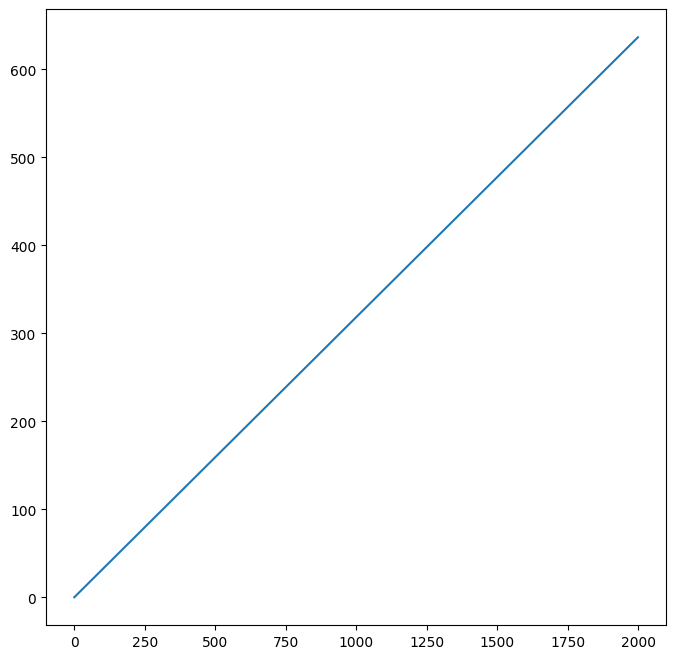

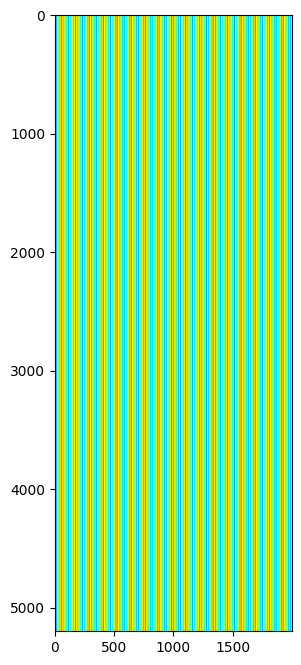

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


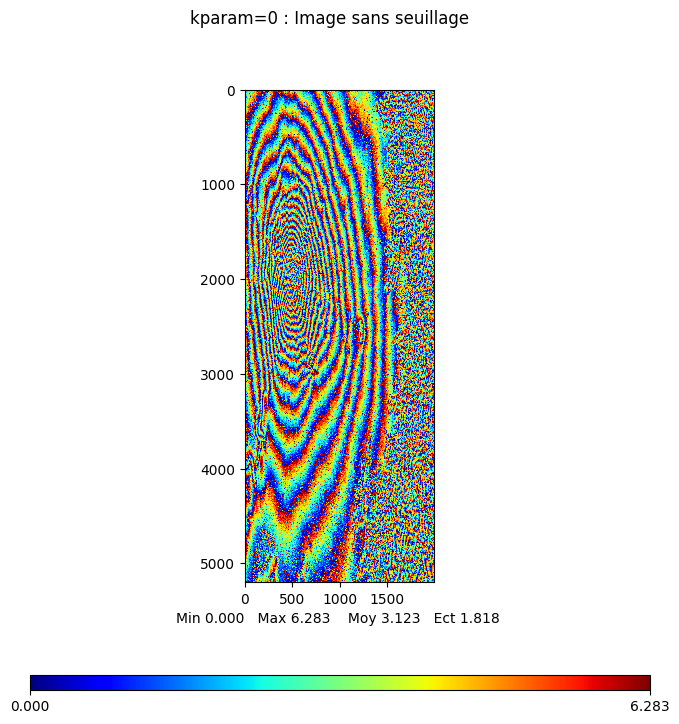

array([[2.72908153, 1.14151189, 1.82106403, ..., 5.05751422, 0.34663267,
        5.48056091],
       [1.57894181, 2.94777466, 3.01463177, ..., 5.27395842, 5.3832695 ,
        5.22079358],
       [0.35468822, 0.20152617, 2.23690111, ..., 5.46284916, 5.69455706,
        3.02911396],
       ...,
       [3.02378009, 0.52046132, 2.58605022, ..., 3.87810957, 0.93493133,
        4.16164984],
       [3.47543084, 1.77081204, 1.02145489, ..., 3.78232856, 1.17743303,
        0.1425248 ],
       [3.72455304, 1.33101545, 3.31711851, ..., 4.06122039, 1.23607527,
        5.04231911]])

In [61]:
theta =  20*np.pi/180 #rad
lambd = 0.0566 #m
Borth = 54.5 #m
R = 826000 #m
c = 299792458 #m/s
Fe = 18.96e6 #Hz

# Compute the global phase shift
delta_x = c/(2*Fe*np.sin(theta))# to be completed
ncolonnes=imamaitre[1]
dephasage_glob = 4*np.pi*Borth*np.cos(theta)/(lambd*R)*delta_x*ncolonnes  # to be completed (global phase shift for the whole image)


# compute the phase shift for each pixel and plot it
rampephase=np.linspace(0.,dephasage_glob,ncolonnes)
plt.figure()
plt.plot(rampephase)
plt.show()

malignephase=np.exp(1j*rampephase)

# Visualize the orbital fringes
orbital_fringes = np.ones((imamaitre[0].shape), dtype=np.complex128)
for juv in range(imamaitre[2]):
    orbital_fringes[juv,:]= malignephase
plt.figure()
plt.imshow(np.angle(orbital_fringes),cmap='jet')
plt.show()

# Compensate the orbital fringe contribution by multiplying the registered slave image with malignephase
imaslavefine = np.multiply(imaslaveroll,malignephase) # to be completed
#compute the new interferogram and comment the effect of the fine registration
# compute the interferogram and plot the interferometric phase
interfero=np.multiply(np.conj(imaslavefine),imamaitre[0]) # to be completed
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Computation of the filtered interferogram


Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


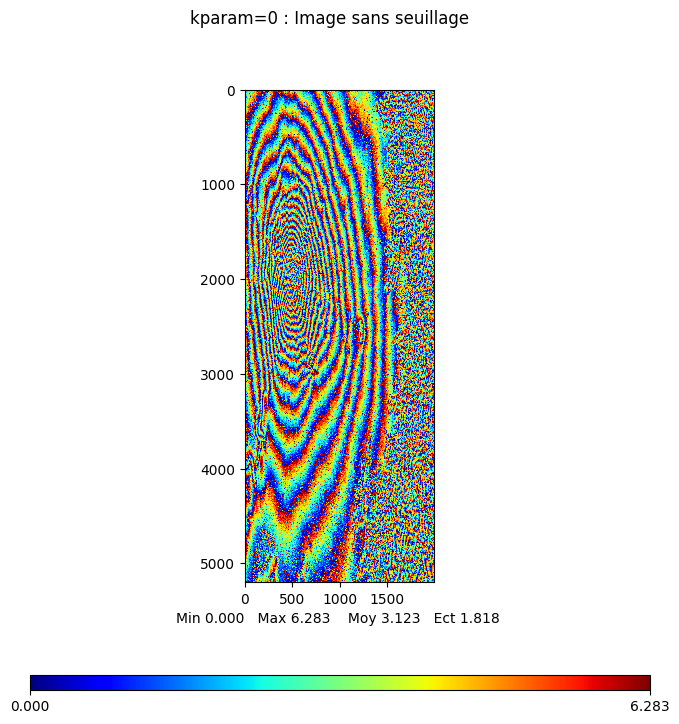

array([[2.72908153, 1.14151189, 1.82106403, ..., 5.05751422, 0.34663267,
        5.48056091],
       [1.57894181, 2.94777466, 3.01463177, ..., 5.27395842, 5.3832695 ,
        5.22079358],
       [0.35468822, 0.20152617, 2.23690111, ..., 5.46284916, 5.69455706,
        3.02911396],
       ...,
       [3.02378009, 0.52046132, 2.58605022, ..., 3.87810957, 0.93493133,
        4.16164984],
       [3.47543084, 1.77081204, 1.02145489, ..., 3.78232856, 1.17743303,
        0.1425248 ],
       [3.72455304, 1.33101545, 3.31711851, ..., 4.06122039, 1.23607527,
        5.04231911]])

In [79]:
#compute the new interferogram and comment the effect of the fine registration
# compute the interferogram and plot the interferometric phase
interfero=np.multiply(np.conj(imaslavefine),imamaitre[0]) # to be completed
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)


### Question 7
What is the ambiguity height ?


In [22]:
h_amb=lambd*R*np.sin(theta)/(2*Borth)
h_amb #Hauteur maximale qu'on peut retrouver en deux phases.  Si on a n franges on a n* ambiguité

146.69714617159937

### Question 8
Which altitude do you find for Etna mount using your interferogram ? (explain)
From the interferometric phase, the height difference can be estimated by counting the number of phase fringes by and multiplying the ambiguity height.
 As we can't compute by hand the number of fringe,  We will try to guess a line where is located the top hill ( here x=2000:,y=500:1500) and count every time the angle in the interefrogram changes from +3.14 to -3.14 , it is is a a new fringe. 
 In this case we counted 123 fringes, so a height of 146*32=4672 meters. This is still higher than  the actual height of the Etna mount (which is 3403) but it could be explained that the peak isn't exactly on the pinpointed position or due to noise in our interferogram, as the peak close to the height of the hill are really close together.

In [90]:
line_to_see=interfero[2000:,500]
line_to_see=(np.angle(interfero))[2000,600:1000]

print("line to see: ",line_to_see)
n_frange=0
for i in range(1,len(line_to_see)):
    print(line_to_see[i-1])
    if (line_to_see[i-1]>2 and line_to_see[i]<-2) or (line_to_see[i-1]<-2 and line_to_see[i]>2):
        print("it changed")
        n_frange+=1
print("Number of fringes: ",n_frange)

line to see:  [ 2.30126867  2.04957128  2.37684395  0.2119546  -1.15316462 -1.03510234
  0.56600153 -0.70189846 -0.69649125 -1.13668764 -0.63374238 -1.515934
 -1.05781997 -1.76589208 -1.53869327 -1.55231131  1.46231583 -0.41710348
  2.54518238 -2.8754715   2.73405657 -2.43317386  0.9166852   1.41442331
  1.73365298  1.32307077  1.23523111  1.19433367  2.06252089 -2.47756086
 -1.73303203 -1.07158892 -0.5740775  -0.10250784  1.81154116  0.75788663
 -0.64809988 -0.77207122 -1.00549762 -2.21030465 -1.16311083 -2.15490239
 -2.28493141 -1.56997087 -2.79264446 -2.89233214 -3.13174403  2.35428775
  2.7964299   2.18040776 -3.06855489  2.10311945  1.28174337  1.55003868
  1.93966739  1.19614903  0.42383889  0.63935885  0.54630974 -0.26017838
  0.05741206  0.04033831  1.80277631 -0.54861164 -0.6569682  -0.74544455
 -1.48806509 -1.10607856 -1.42792858 -1.52495428 -1.8775601  -2.00299941
 -2.11662615 -2.40089804 -2.5419872  -2.56665314  2.84111317 -2.97419124
  2.67661678  2.42864395  1.72925046  2

### Question 9
Which are the areas of low coherence ? Explain why.
The low-coherence areas in the interferogram appear primarily in the ground regions surrounding Mount Etna.

These areas correspond to regions where the interferometric phase is highly decorrelated, resulting in a randomly distributed pattern with no well-defined fringes.

The most likely causes of this low coherence is the Vegetation cover around Mount Etna, which induces temporal decorrelation due to changes in structure and moisture content. It could have been due to water like river but I didn't see any of these with google earth 
